# Refine tangram annotations using clustering for breast_s6

In [1]:
slide_id = "breast_s6"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [4]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_breast_s6.zarr
├── Images
│     ├── 'he': DataTree[cyx] (3, 37433, 57382), (3, 18717, 28691), (3, 9359, 14346), (3, 4680, 7173), (3, 2340, 3587), (3, 1170, 1794), (3, 585, 897), (3, 293, 449)
│     └── 'morpho': DataTree[cyx] (5, 74945, 51265), (5, 37472, 25632), (5, 18736, 12816), (5, 9368, 6408), (5, 4684, 3204)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (692184, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (692184, 8232)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), morpho (Images), st (Points), nucleus_boundaries (Shapes)

In [5]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_37418/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 692184 × 8232
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [6]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,105.394016,CXCL14 mammary basal cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,149.197018,CXCL14 mammary basal cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,110.112903,CXCL14 mammary basal cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,145.719006,CXCL14 mammary basal cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,49.897293,CXCL+ fibroblast
...,...,...,...,...,...
aaakipnd-1,nucleus_boundaries,morpho,aaakipnd-1,17.429026,Mast cell
aaakipne-1,nucleus_boundaries,morpho,aaakipne-1,5.847963,Mast cell
aaakipnf-1,nucleus_boundaries,morpho,aaakipnf-1,7.495014,CREB+MT1A+ vascular smooth muscle cell
aaakipng-1,nucleus_boundaries,morpho,aaakipng-1,7.609824,Dendritic cell


In [7]:
adata_ini.var

""
A2ML1
AAMP
AAR2
AARSD1
ABAT
...
ZSCAN26
ZSWIM6
ZUP1
ZYG11B


## 2. Preprocessing

In [8]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,105.394016,CXCL14 mammary basal cell,455
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,149.197018,CXCL14 mammary basal cell,626
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,110.112903,CXCL14 mammary basal cell,509
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,145.719006,CXCL14 mammary basal cell,622
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,49.897293,CXCL+ fibroblast,205
...,...,...,...,...,...,...
aaakipnd-1,nucleus_boundaries,morpho,aaakipnd-1,17.429026,Mast cell,9
aaakipne-1,nucleus_boundaries,morpho,aaakipne-1,5.847963,Mast cell,1
aaakipnf-1,nucleus_boundaries,morpho,aaakipnf-1,7.495014,CREB+MT1A+ vascular smooth muscle cell,4
aaakipng-1,nucleus_boundaries,morpho,aaakipng-1,7.609824,Dendritic cell,1


<Axes: >

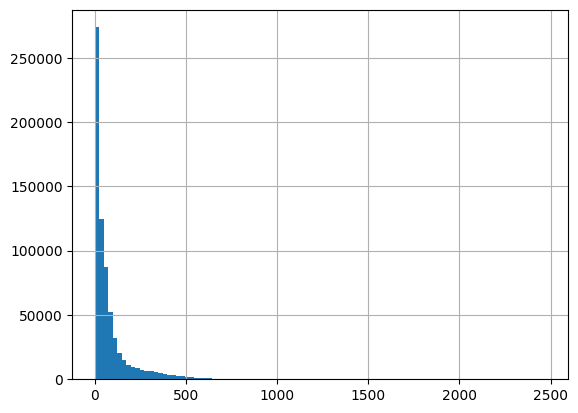

In [9]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

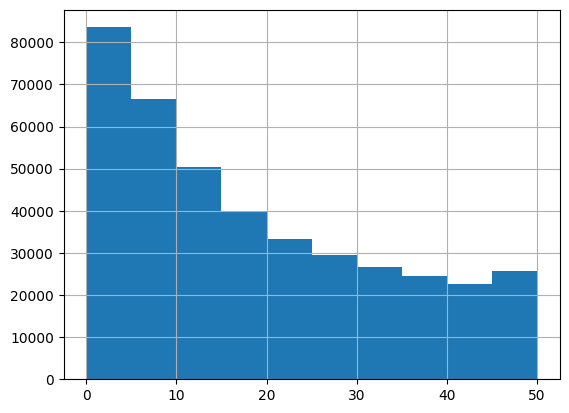

In [10]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [11]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 240307
Percentage of cells with less than 20 transcripts: 34.72%
-----
Number of cells with less than 15 transcripts: 200314
Percentage of cells with less than 15 transcripts: 28.94%
-----
Number of cells with less than 10 transcripts: 150029
Percentage of cells with less than 10 transcripts: 21.67%
-----
Number total of cells: 692184


In [12]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

530942


In [13]:
# Save and do clustering on ruche using gpu
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_att/adata_for_gpu_clustering_{slide_id}.h5ad")

In [ ]:
# # Save the raw data
# adata.layers['count'] = adata.X.copy()

In [ ]:
# # Normalize
# sc.pp.normalize_total(adata, target_sum=1e4)
# sc.pp.log1p(adata)
# adata.layers['log_norm'] = adata.X.copy()

In [ ]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata, log=True)

In [ ]:
# adata

In [ ]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata, neighbors_key='pca_n20_pcs16', min_dist=0.6)
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [4]:
# reload adata after clustring on ruche
adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_att/adata_after_gpu_clustering_{slide_id}.h5ad")

In [5]:
adata

AnnData object with n_obs × n_vars = 530942 × 8232
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

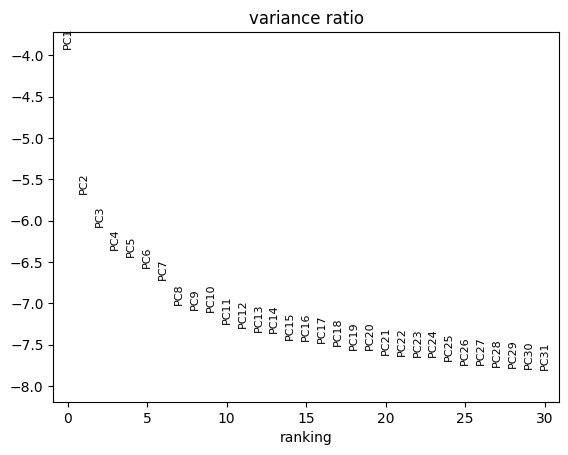

In [6]:
sc.pl.pca_variance_ratio(adata, log=True)

In [7]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata.layers['count'].sum()}")
print(f"Sum log_norm: {adata.layers['log_norm'].sum()}")
print(f"Sum X: {adata.X.sum()}")

Sum count: 53547616.0
Sum log_norm: 161743216.0
Sum X: 161743216.0


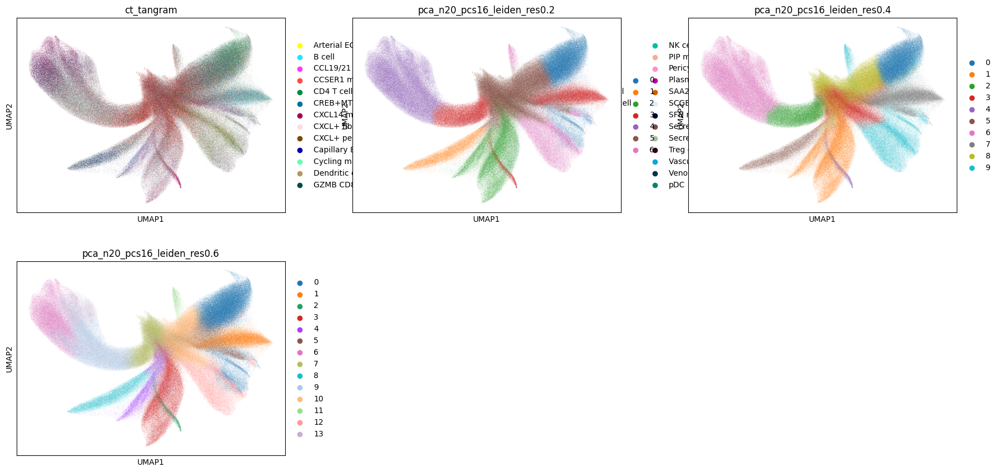

In [8]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16',
           color=['ct_tangram', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3)

In [9]:
# Number of clusters
adata.obs['pca_n20_pcs16_leiden_res0.6'].unique()

['6', '9', '0', '11', '10', ..., '2', '8', '13', '7', '4']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [10]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'

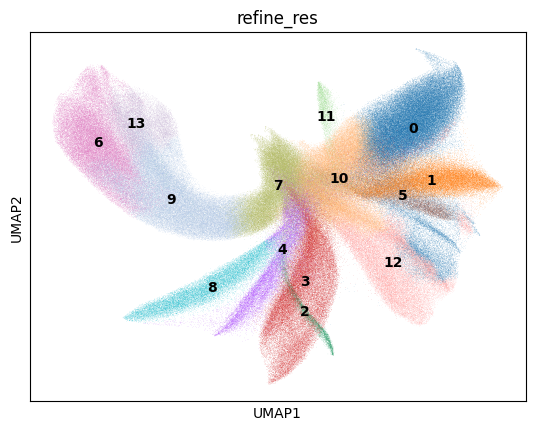

In [11]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [12]:
clustering_label = 'refine_res'

In [13]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_44309/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


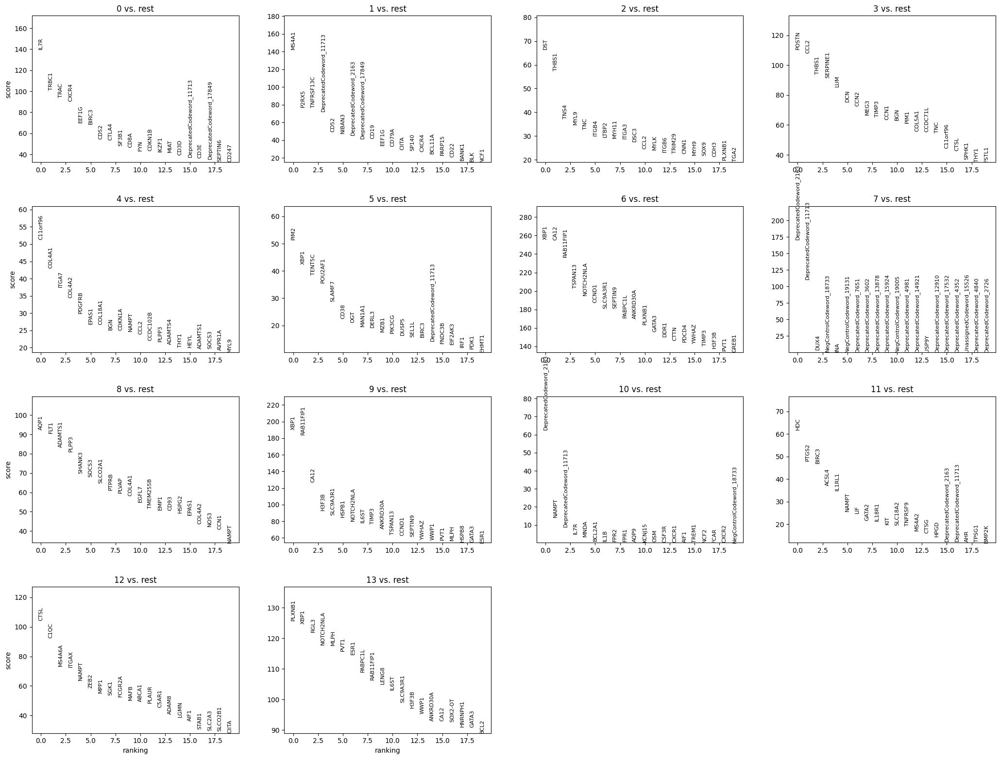

In [14]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [15]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [16]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [17]:
cluster_id = '0'

In [18]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,CD4 T cell,16
1,0,GZMB CD8 T cell,9
2,0,Monocyte,6
3,0,Macrophage,4
4,0,Treg cell,4
5,0,GZMK CD8 T cell,4
6,0,Cycling mammary luminal progenitor,4


In [19]:
top_ranked_genes[cluster_id]

0     IL7R
1    TRBC1
2     TRAC
3    CXCR4
4    EEF1G
5    BIRC3
6     CD52
Name: 0, dtype: object

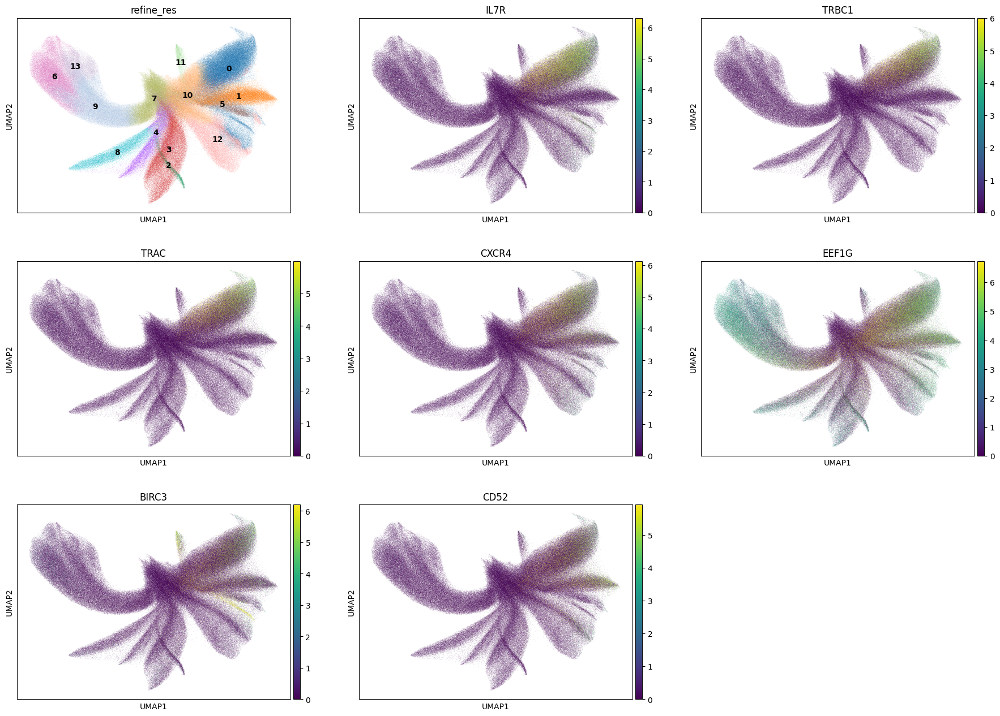

In [20]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [21]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 96860
Percentage of cells in cluster 0: 18.2


In [22]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.2. Cluster 1

In [23]:
cluster_id = '1'

In [24]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,B cell,21
8,1,Mast cell,9
9,1,pDC,7
10,1,Plasma cell,4
11,1,Monocyte,4
12,1,Cycling mammary luminal progenitor,3
13,1,Arterial EC,3


In [25]:
top_ranked_genes[cluster_id]

0                       MS4A1
1                       P2RX5
2                   TNFRSF13C
3    DeprecatedCodeword_11713
4                        CD52
5                      NIBAN3
6     DeprecatedCodeword_2163
Name: 1, dtype: object

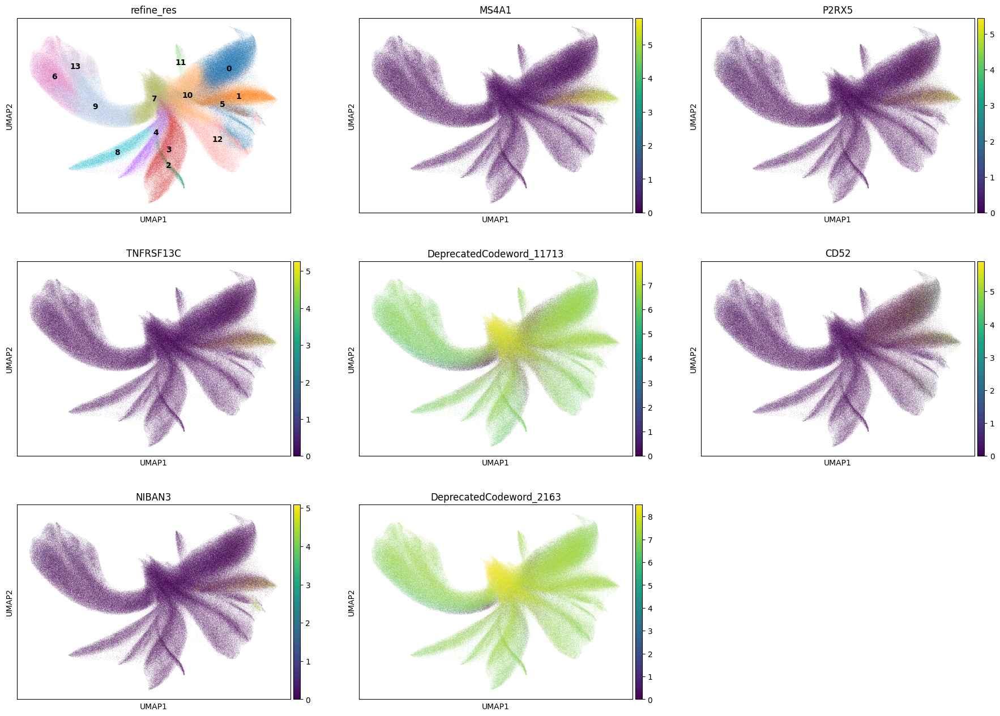

In [26]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [27]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 35765
Percentage of cells in cluster 1: 6.7


In [28]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.3. Cluster 2

In [29]:
cluster_id = '2'

In [30]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,CXCL14 mammary basal cell,48
15,2,Mast cell,6
16,2,CCSER1 mammary basal cell,5
17,2,Secretoglobin mammary luminal progenitor,4
18,2,KRT6B mammary basal cell,4
19,2,CREB+MT1A+ vascular smooth muscle cell,3
20,2,Cycling mammary luminal progenitor,2


In [31]:
top_ranked_genes[cluster_id]

0      DST
1    THBS1
2     TNS4
3     MYL9
4      TNC
5    ITGB4
6    LTBP2
Name: 2, dtype: object

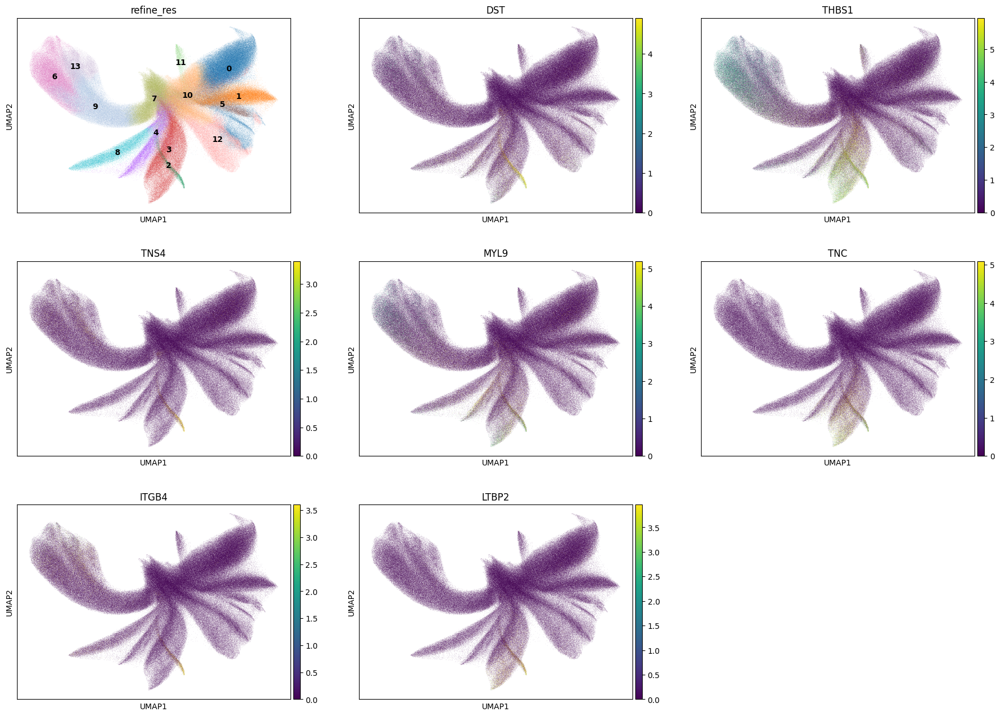

In [32]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [33]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 5116
Percentage of cells in cluster 2: 1.0


In [34]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.4. Cluster 3

In [35]:
cluster_id = '3'

In [36]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Mast cell,20
22,3,CXCL+ fibroblast,11
23,3,IGFBP6+APOD+ fibroblast,10
24,3,IGFBP6+SFRP4+ fibroblast,5
25,3,CXCL14 mammary basal cell,5
26,3,CCL19/21 pericyte,4
27,3,CCSER1 mammary basal cell,4


In [37]:
top_ranked_genes[cluster_id]

0       POSTN
1        CCL2
2       THBS1
3    SERPINE1
4         LUM
5         DCN
6        CCN2
Name: 3, dtype: object

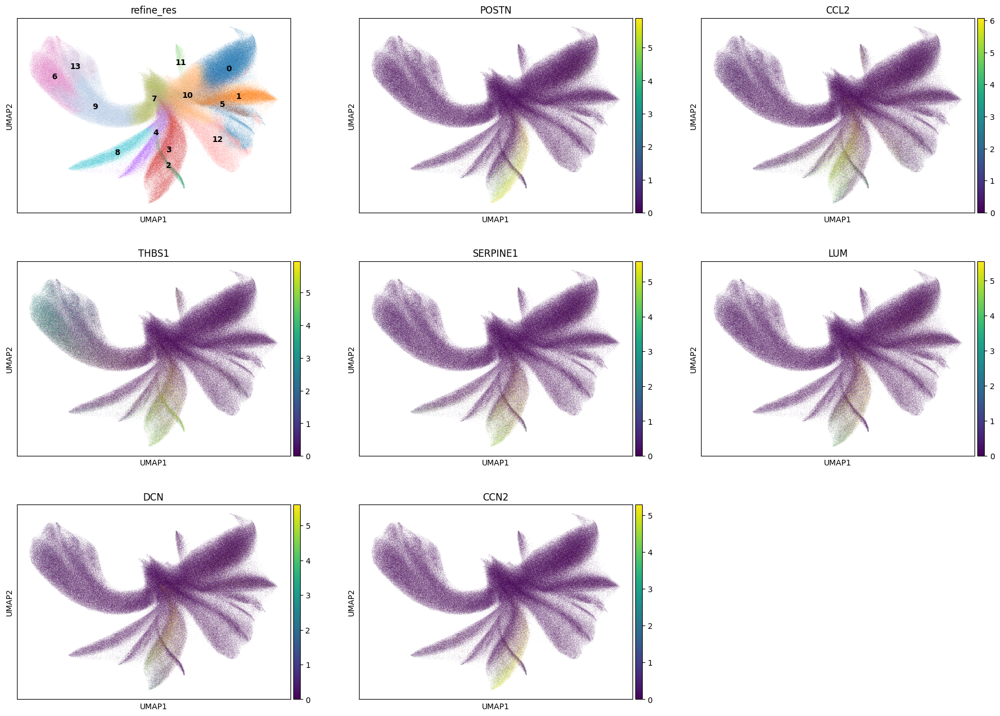

In [38]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [39]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 52938
Percentage of cells in cluster 3: 10.0


In [40]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.5. Cluster 4

In [41]:
cluster_id = '4'

In [42]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Mast cell,24
29,4,CREB+MT1A+ vascular smooth muscle cell,12
30,4,CCL19/21 pericyte,8
31,4,Venous EC,5
32,4,Pericyte,4
33,4,Capillary EC,3
34,4,CCSER1 mammary basal cell,3


In [43]:
top_ranked_genes[cluster_id]

0    C11orf96
1      COL4A1
2       ITGA7
3      COL4A2
4      PDGFRB
5       EPAS1
6     COL18A1
Name: 4, dtype: object

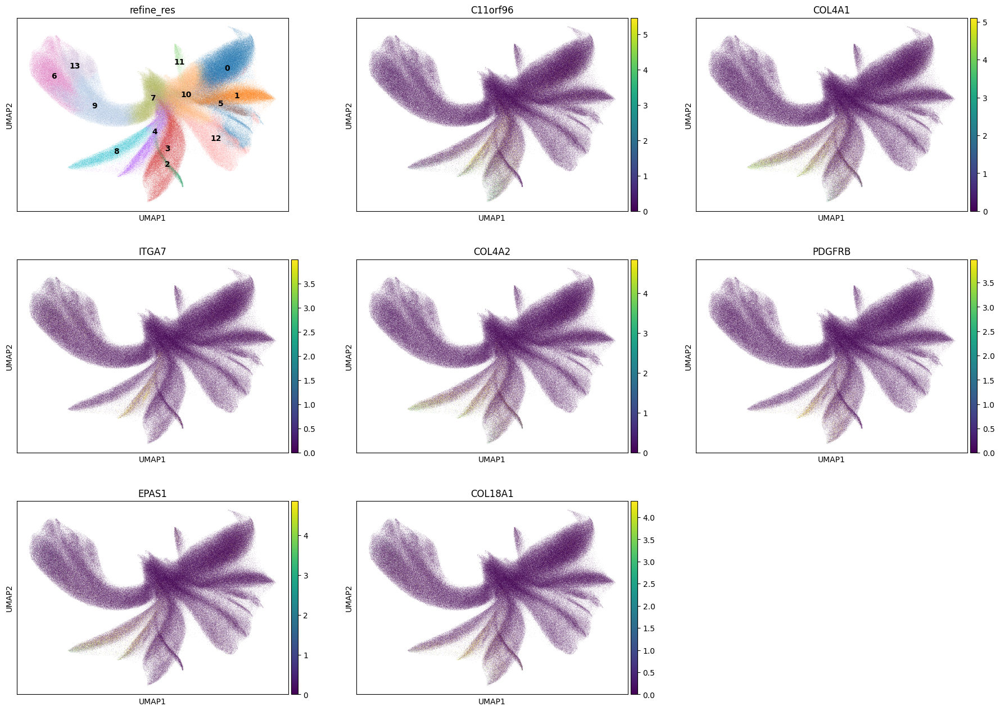

In [44]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [45]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 22931
Percentage of cells in cluster 4: 4.3


In [46]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [47]:
cluster_id = '5'

In [48]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Plasma cell,17
36,5,Mast cell,11
37,5,pDC,8
38,5,Macrophage,4
39,5,GZMK CD8 T cell,3
40,5,Cycling mammary luminal progenitor,3
41,5,Monocyte,3


In [49]:
top_ranked_genes[cluster_id]

0       PIM2
1       XBP1
2     TENT5C
3    POU2AF1
4     SLAMF7
5       CD38
6        OGT
Name: 5, dtype: object

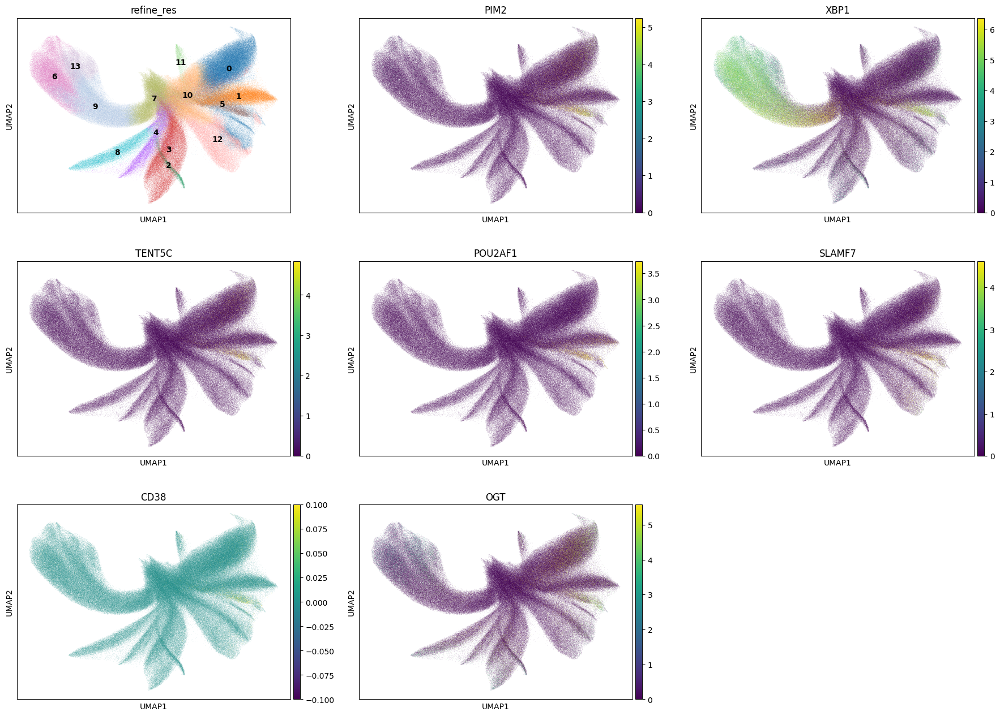

In [50]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [51]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 12485
Percentage of cells in cluster 5: 2.4


In [52]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.7. Cluster 6

In [53]:
cluster_id = '6'

In [54]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,CXCL14 mammary basal cell,33
43,6,SFN mammary luminal progenitor,29
44,6,Secretoglobin mammary luminal progenitor,8
45,6,Cycling mammary luminal progenitor,8
46,6,Venous EC,5
47,6,KRT6B mammary basal cell,4
48,6,PIP mammary luminal cell,3


In [55]:
top_ranked_genes[cluster_id]

0         XBP1
1         CA12
2    RAB11FIP1
3      TSPAN13
4    NOTCH2NLA
5        CCND1
6     SLC9A3R1
Name: 6, dtype: object

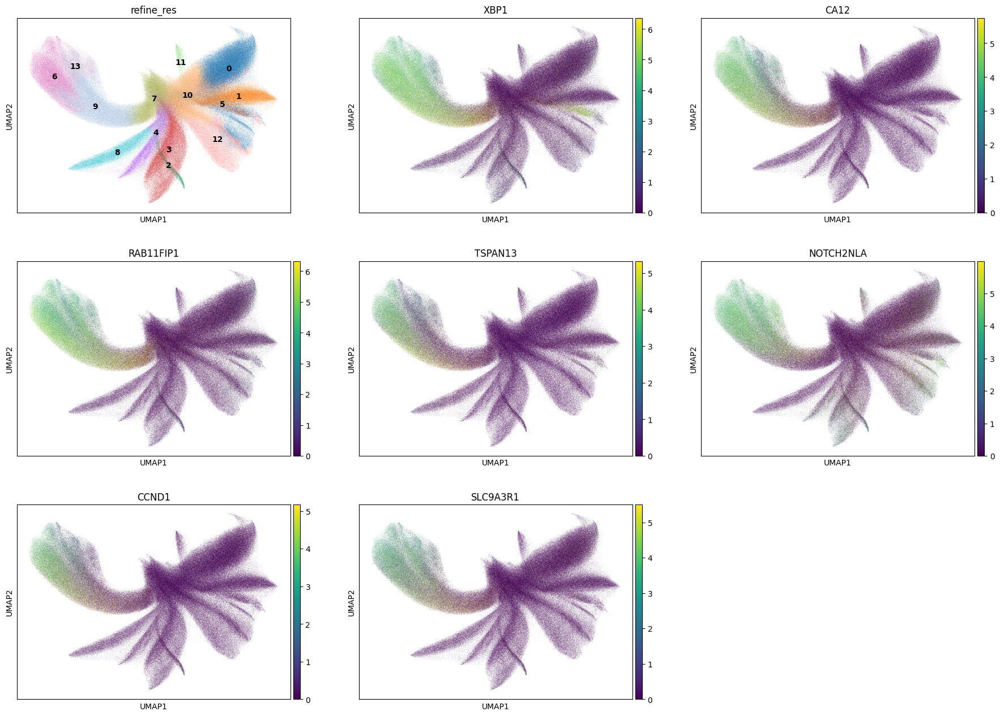

In [56]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [57]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 45591
Percentage of cells in cluster 6: 8.6


In [58]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

### 5.8. Cluster 7

In [59]:
cluster_id = '7'

In [60]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Mast cell,53
50,7,NK cell,3
51,7,Cycling mammary luminal progenitor,3
52,7,CCL19/21 pericyte,2
53,7,Lactocyte,2
54,7,Monocyte,2
55,7,IGFBP6+SFRP4+ fibroblast,2


In [61]:
top_ranked_genes[cluster_id]

0     DeprecatedCodeword_2163
1    DeprecatedCodeword_11713
2                        DUX4
3    NegControlCodeword_18733
4                         INA
5    NegControlCodeword_19131
6     DeprecatedCodeword_7651
Name: 7, dtype: object

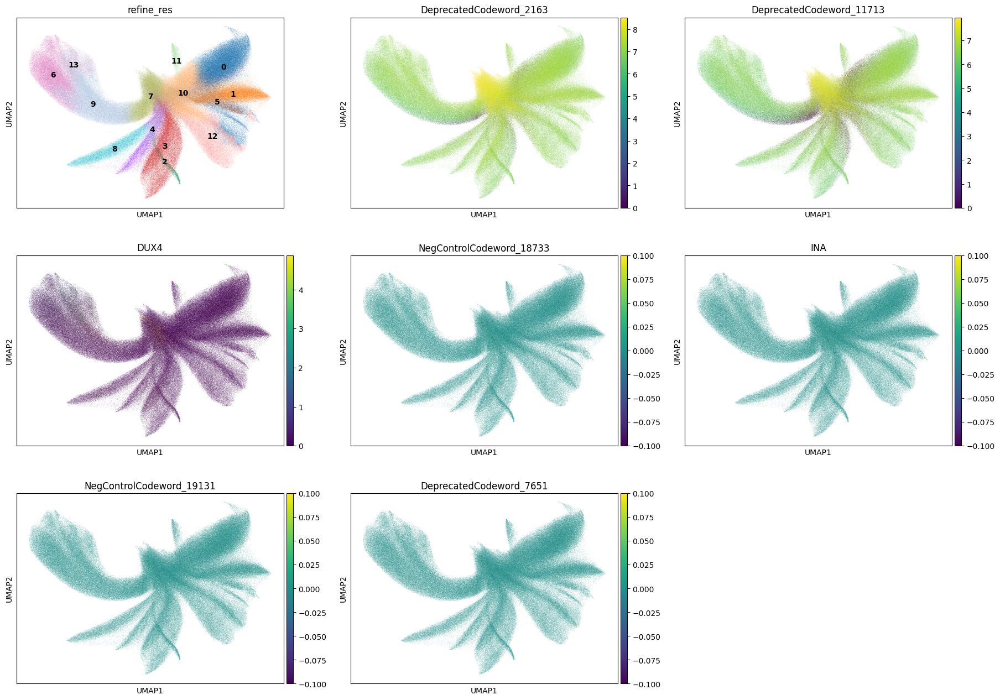

In [62]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [63]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 52096
Percentage of cells in cluster 7: 9.8


In [64]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.9. Cluster 8

In [65]:
cluster_id = '8'

In [66]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Venous EC,44
57,8,Capillary EC,12
58,8,Mast cell,7
59,8,Arterial EC,6
60,8,CXCL14 mammary basal cell,4
61,8,CREB+MT1A+ vascular smooth muscle cell,3
62,8,CCL19/21 pericyte,2


In [67]:
top_ranked_genes[cluster_id]

0       AQP1
1       FLT1
2    ADAMTS1
3      PLPP3
4     SHANK3
5      SOCS3
6    SLCO2A1
Name: 8, dtype: object

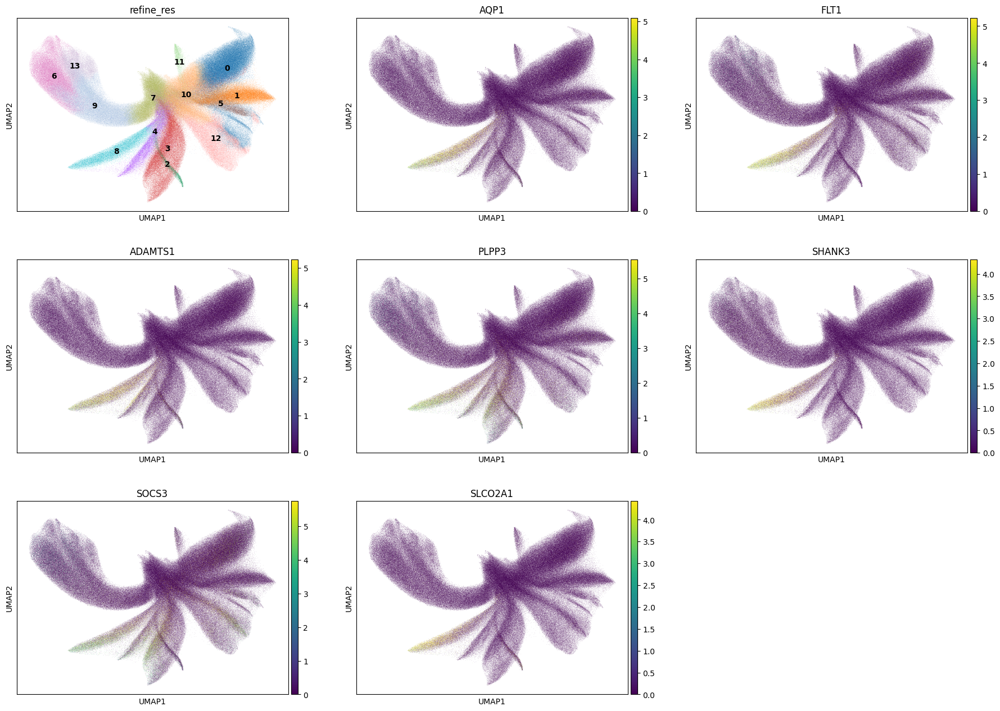

In [68]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [69]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 20138
Percentage of cells in cluster 8: 3.8


In [70]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenesis_endothelial'

### 5.10. Cluster 9

In [71]:
cluster_id = '9'

In [72]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Mast cell,14
64,9,CXCL14 mammary basal cell,8
65,9,Cycling mammary luminal progenitor,7
66,9,Secretoglobin mammary luminal progenitor,5
67,9,CREB+MT1A+ vascular smooth muscle cell,4
68,9,Venous EC,4
69,9,CCSER1 mammary basal cell,4


In [73]:
top_ranked_genes[cluster_id]

0         XBP1
1    RAB11FIP1
2         CA12
3        H3F3B
4     SLC9A3R1
5        HSPB1
6    NOTCH2NLA
Name: 9, dtype: object

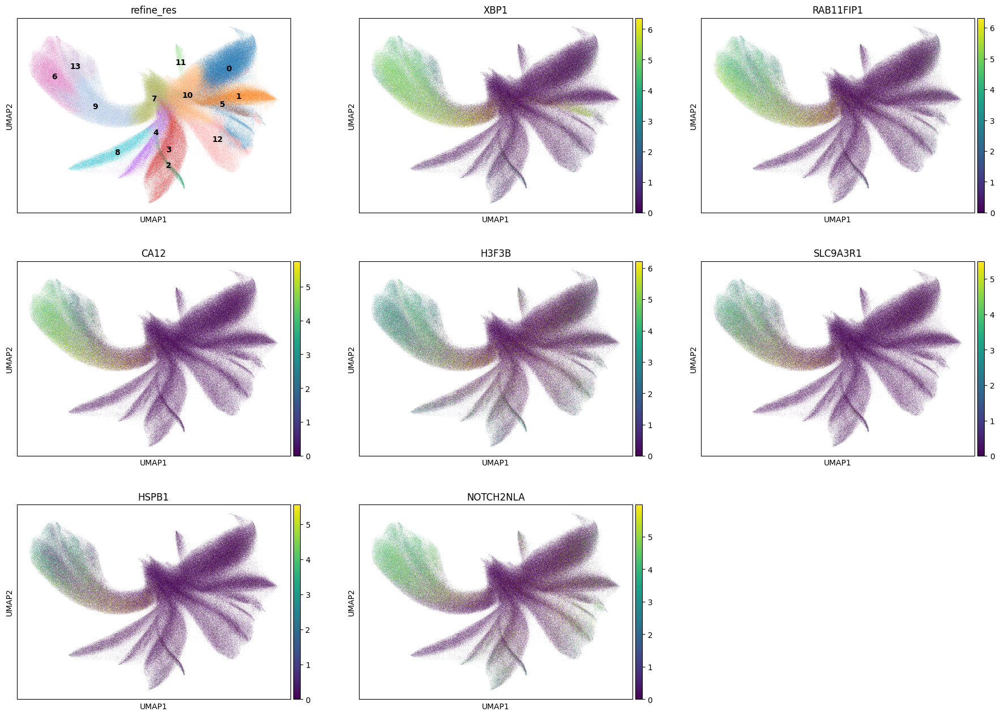

In [74]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [75]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 60686
Percentage of cells in cluster 9: 11.4


In [76]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

### 5.11. Cluster 10

In [77]:
cluster_id = '10'

In [78]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Mast cell,38
71,10,Monocyte,6
72,10,Treg cell,5
73,10,NK cell,5
74,10,pDC,4
75,10,Dendritic cell,4
76,10,LYVE1 macrophage,3


In [79]:
top_ranked_genes[cluster_id]

0     DeprecatedCodeword_2163
1                       NAMPT
2    DeprecatedCodeword_11713
3                        IL7R
4                        MNDA
5                      BCL2A1
6                        IL1B
Name: 10, dtype: object

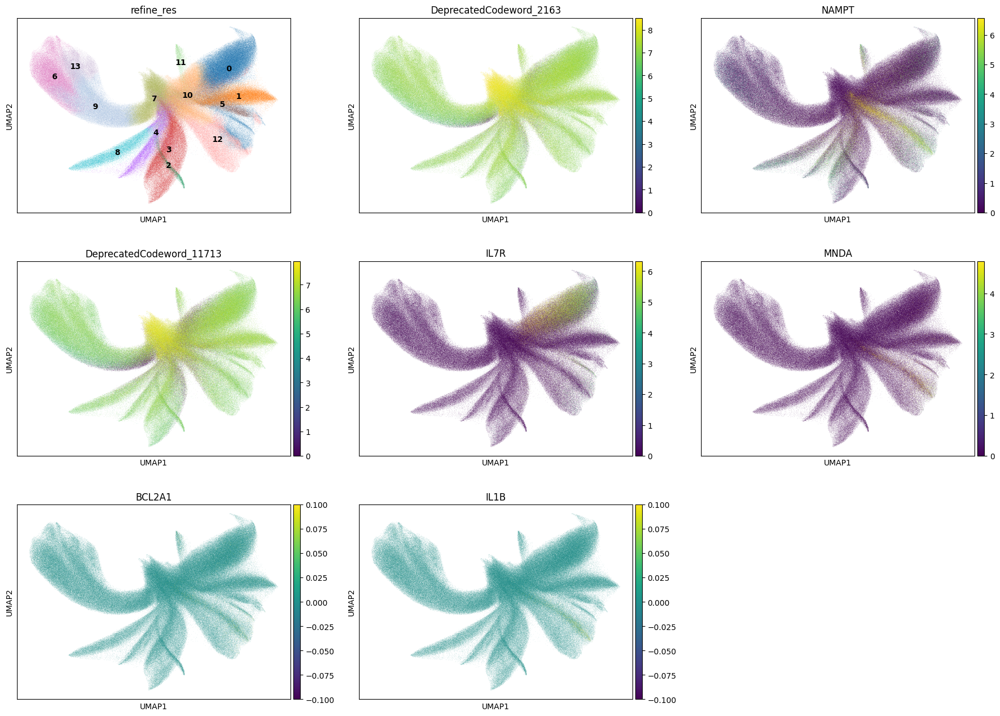

In [80]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [81]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 72850
Percentage of cells in cluster 10: 13.7


In [82]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.12. Cluster 11

In [83]:
cluster_id = '11'

In [84]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
77,11,Mast cell,27
78,11,Monocyte,6
79,11,Dendritic cell,4
80,11,CXCL+ fibroblast,4
81,11,pDC,4
82,11,M1 macrophage,3
83,11,CXCL+ pericyte,3


In [85]:
top_ranked_genes[cluster_id]

0       HDC
1     PTGS2
2     BIRC3
3     ACSL4
4    IL1RL1
5     NAMPT
6       LIF
Name: 11, dtype: object

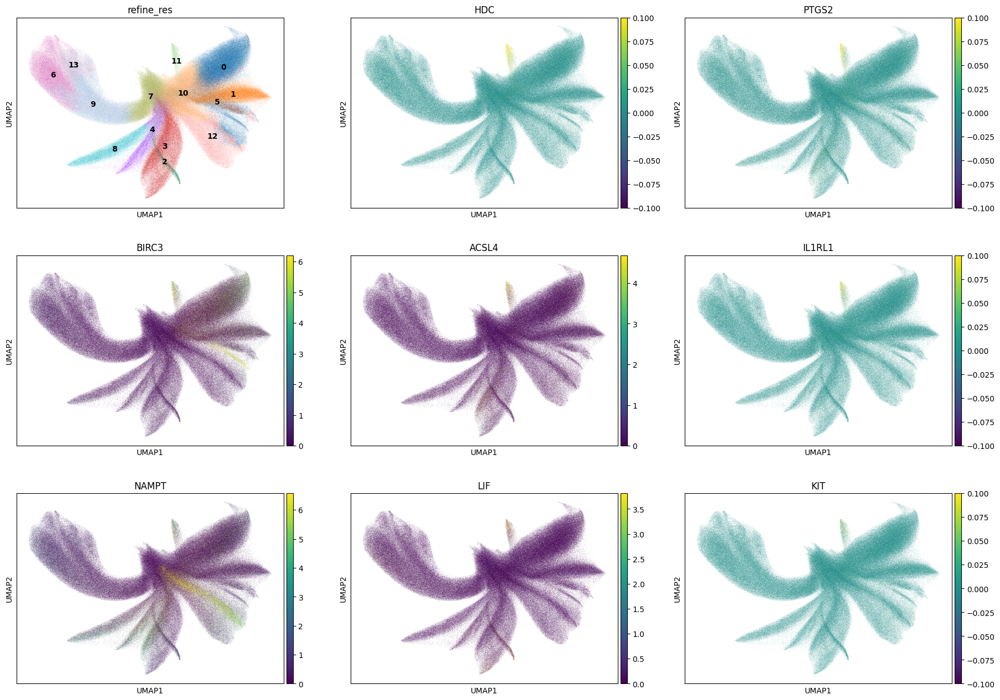

In [88]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7]+['KIT'], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 4591
Percentage of cells in cluster 11: 0.9


In [89]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.13. Cluster 12

In [90]:
cluster_id = '12'

In [91]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
84,12,Monocyte,20
85,12,Macrophage,17
86,12,LYVE1 macrophage,10
87,12,M1 macrophage,6
88,12,Venous EC,6
89,12,Mast cell,5
90,12,CREB+MT1A+ vascular smooth muscle cell,3


In [92]:
top_ranked_genes[cluster_id]

0      CTSL
1      C1QC
2    MS4A6A
3     ITGAX
4     NAMPT
5      ZEB2
6      MPP1
Name: 12, dtype: object

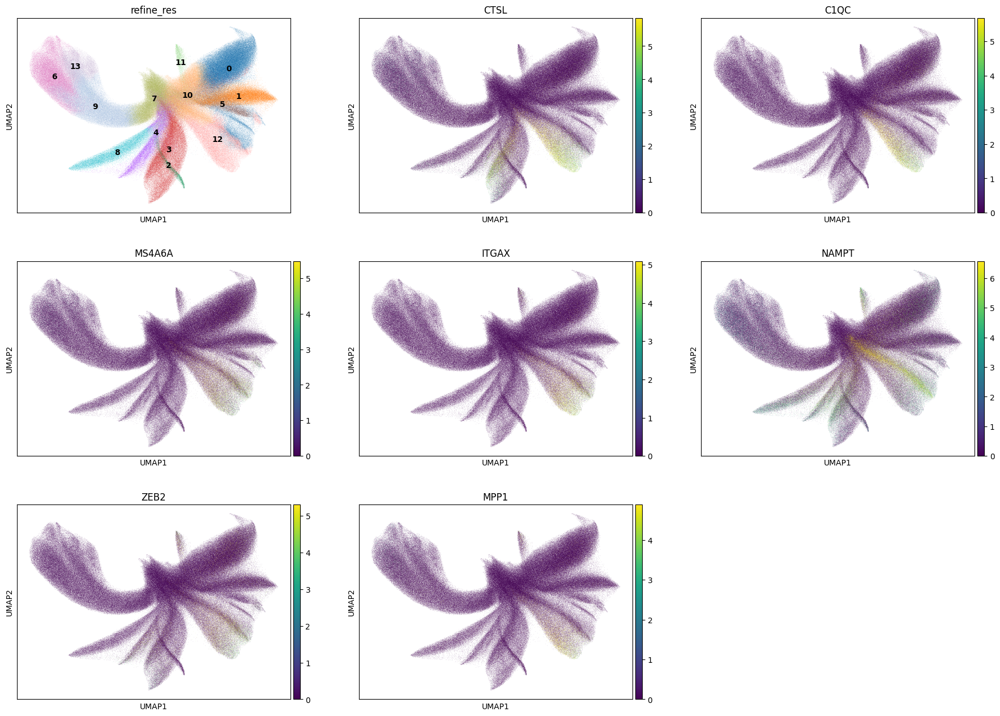

In [93]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [94]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 32580
Percentage of cells in cluster 12: 6.1


In [95]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.14. Cluster 13

In [96]:
cluster_id = '13'

In [97]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
91,13,CXCL14 mammary basal cell,33
92,13,SFN mammary luminal progenitor,30
93,13,Secretoglobin mammary luminal progenitor,10
94,13,Venous EC,7
95,13,KRT6B mammary basal cell,6
96,13,PIP mammary luminal cell,5
97,13,Cycling mammary luminal progenitor,3


In [98]:
top_ranked_genes[cluster_id]

0       PLXNB1
1         XBP1
2         RGL3
3    NOTCH2NLA
4         MLPH
5         PVT1
6         ESR1
Name: 13, dtype: object

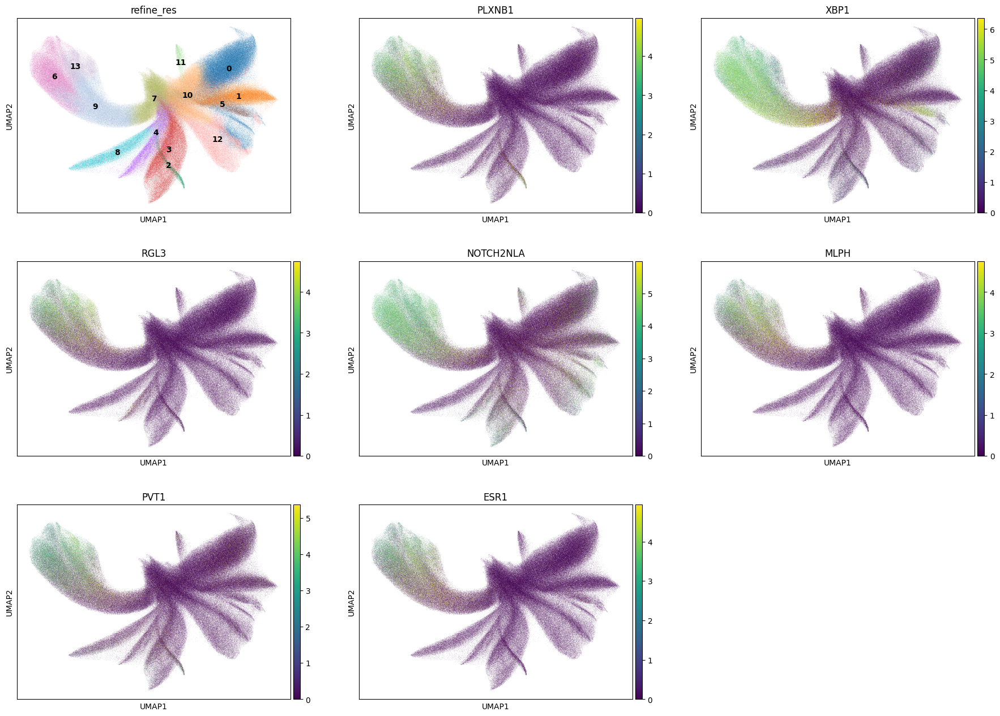

In [99]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [100]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 16315
Percentage of cells in cluster 13: 3.1


In [101]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Breast_epithelial_cell'

## 6. Cancer cells

In [104]:
adata.obs['label1'].unique()

array(['Epithelial', 'T', 'Mast', 'Unknown', 'Plasma', 'Fibroblast', 'B',
       'Monocyte/Macrophage/DC', 'Endothelial'], dtype=object)

In [105]:
adata.obs['label2'].unique()

array(['Breast_epithelial_cell', 'T', 'Mast', 'Unknown', 'Plasma', 'CAF',
       'B', 'Monocyte/Macrophage/DC', 'Fibroblast',
       'Angiogenesis_endothelial', 'Endothelial'], dtype=object)

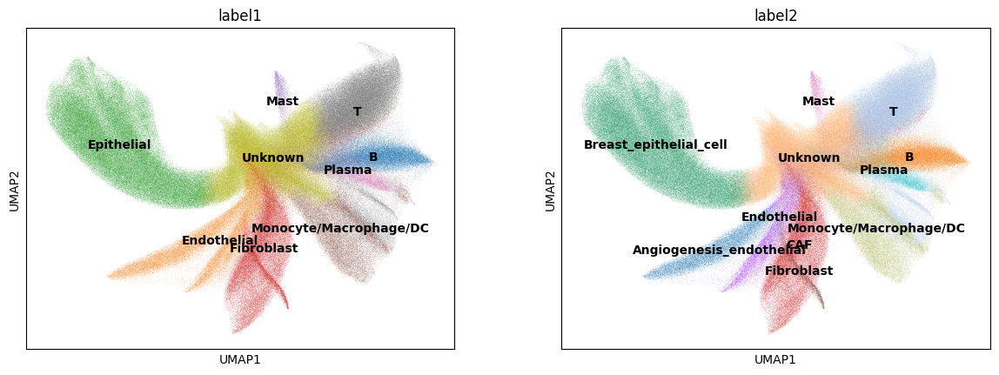

In [106]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [107]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

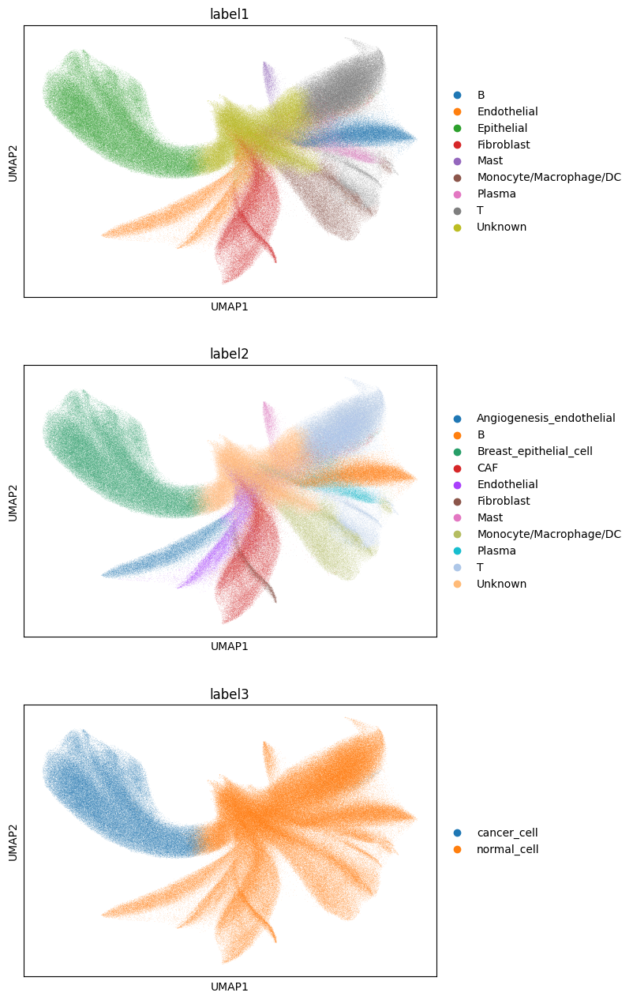

In [108]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [109]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,105.394016,CXCL14 mammary basal cell,455,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,149.197018,CXCL14 mammary basal cell,626,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,110.112903,CXCL14 mammary basal cell,509,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,145.719006,CXCL14 mammary basal cell,622,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,49.897293,CXCL+ fibroblast,205,4,6,6,6,Epithelial,Breast_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaakipmb-1,nucleus_boundaries,morpho,aaakipmb-1,10.454180,Mast cell,11,5,3,10,10,Unknown,Unknown,normal_cell
aaakipmc-1,nucleus_boundaries,morpho,aaakipmc-1,9.482242,Dendritic cell,20,5,8,10,10,Unknown,Unknown,normal_cell
aaakipmf-1,nucleus_boundaries,morpho,aaakipmf-1,17.814421,IGFBP6+APOD+ fibroblast,33,5,8,10,10,Unknown,Unknown,normal_cell
aaakipmk-1,nucleus_boundaries,morpho,aaakipmk-1,6.953430,Mast cell,11,5,8,7,7,Unknown,Unknown,normal_cell


In [110]:
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")